# Import Libraries/Function

In [304]:
#Import Generic Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px


#Categorical Encoding
import category_encoders as ce


#Preprocess
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

#Modeling Libraries
from sklearn.linear_model import LogisticRegression, SGDRegressor, SGDClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier

#Estimators
from sklearn.linear_model import Lasso

#Optimization
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import GridSearchCV, HalvingRandomSearchCV
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SequentialFeatureSelector, SelectFromModel

#Metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix

#Storing Model
import pickle

#Others
import time
import warnings

# EDA/EMA | Use CRISP-DM

1. Business Understanding
2. Data Understanding
3. Data Preparation
4. Modeling
5. Evaluation

## Business Understanding

**The classification goal is to predict if the client will subscribe a term deposit (variable y).**
<br>
**For this project, it would be great to have a score of `80%` accordingly**

The data is related with direct marketing campaigns of a Portuguese banking institution. 
The marketing campaigns were based on phone calls. Often, more than one contact to the same client was required, in order to access if the product (bank term deposit) would be (or not) subscribed. 

Note: Term Deposits are deposits that are usually made for a few months to several years and reward you with guaranteed returns.

## Data Understanding

In [3]:
df = pd.read_csv('bank-full.csv', sep=';')
df

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51,technician,married,tertiary,no,825,no,no,cellular,17,nov,977,3,-1,0,unknown,yes
45207,71,retired,divorced,primary,no,1729,no,no,cellular,17,nov,456,2,-1,0,unknown,yes
45208,72,retired,married,secondary,no,5715,no,no,cellular,17,nov,1127,5,184,3,success,yes
45209,57,blue-collar,married,secondary,no,668,no,no,telephone,17,nov,508,4,-1,0,unknown,no


In [4]:
# The data is related with direct marketing campaigns of a Portuguese banking institution. 
#    The marketing campaigns were based on phone calls. Often, more than one contact to the same client was required, 
#    in order to access if the product (bank term deposit) would be (or not) subscribed. 

#  Input variables:
#    # bank client data:
#    1 - age (numeric)
#    2 - job : type of job (categorical: "admin.","unknown","unemployed","management","housemaid","entrepreneur","student",
#                                        "blue-collar","self-employed","retired","technician","services") 
#    3 - marital : marital status (categorical: "married","divorced","single"; note: "divorced" means divorced or widowed)
#    4 - education (categorical: "unknown","secondary","primary","tertiary")
#    5 - default: has credit in default? (binary: "yes","no")
#    6 - balance: average yearly balance, in euros (numeric) 
#    7 - housing: has housing loan? (binary: "yes","no")
#    8 - loan: has personal loan? (binary: "yes","no")
#    # related with the last contact of the current campaign:
#    9 - contact: contact communication type (categorical: "unknown","telephone","cellular") 
#   10 - day: last contact day of the month (numeric)
#   11 - month: last contact month of year (categorical: "jan", "feb", "mar", ..., "nov", "dec")
#   12 - duration: last contact duration, in seconds (numeric)
#    # other attributes:
#   13 - campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)
#   14 - pdays: number of days that passed by after the client was last contacted from a previous campaign (numeric, -1 means client was not previously contacted)
#   15 - previous: number of contacts performed before this campaign and for this client (numeric)
#   16 - poutcome: outcome of the previous marketing campaign (categorical: "unknown","other","failure","success")

#   Output variable (desired target):
#   17 - y - has the client subscribed a term deposit? (binary: "yes","no")


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  int64 
 1   job        45211 non-null  object
 2   marital    45211 non-null  object
 3   education  45211 non-null  object
 4   default    45211 non-null  object
 5   balance    45211 non-null  int64 
 6   housing    45211 non-null  object
 7   loan       45211 non-null  object
 8   contact    45211 non-null  object
 9   day        45211 non-null  int64 
 10  month      45211 non-null  object
 11  duration   45211 non-null  int64 
 12  campaign   45211 non-null  int64 
 13  pdays      45211 non-null  int64 
 14  previous   45211 non-null  int64 
 15  poutcome   45211 non-null  object
 16  y          45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [6]:
df_v1 = df.convert_dtypes()
df_v1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  Int64 
 1   job        45211 non-null  string
 2   marital    45211 non-null  string
 3   education  45211 non-null  string
 4   default    45211 non-null  string
 5   balance    45211 non-null  Int64 
 6   housing    45211 non-null  string
 7   loan       45211 non-null  string
 8   contact    45211 non-null  string
 9   day        45211 non-null  Int64 
 10  month      45211 non-null  string
 11  duration   45211 non-null  Int64 
 12  campaign   45211 non-null  Int64 
 13  pdays      45211 non-null  Int64 
 14  previous   45211 non-null  Int64 
 15  poutcome   45211 non-null  string
 16  y          45211 non-null  string
dtypes: Int64(7), string(10)
memory usage: 6.2 MB


In [7]:
df_v1.describe()

,age,balance,day,duration,campaign,pdays,previous
count,45211.0,45211.0,45211.0,45211.0,45211.0,45211.0,45211.0
mean,40.93621,1362.272058,15.806419,258.16308,2.763841,40.197828,0.580323
std,10.618762,3044.765829,8.322476,257.527812,3.098021,100.128746,2.303441
min,18.0,-8019.0,1.0,0.0,1.0,-1.0,0.0
25%,33.0,72.0,8.0,103.0,1.0,-1.0,0.0
50%,39.0,448.0,16.0,180.0,2.0,-1.0,0.0
75%,48.0,1428.0,21.0,319.0,3.0,-1.0,0.0
max,95.0,102127.0,31.0,4918.0,63.0,871.0,275.0


In [8]:
df_v1.describe(include='string')

,job,marital,education,default,housing,loan,contact,month,poutcome,y
count,45211,45211,45211,45211,45211,45211,45211,45211,45211,45211
unique,12,3,4,2,2,2,3,12,4,2
top,blue-collar,married,secondary,no,yes,no,cellular,may,unknown,no
freq,9732,27214,23202,44396,25130,37967,29285,13766,36959,39922


## Data Preparation

In [9]:
df_v2 = df_v1.copy()
cat_values_bin = ["default", "housing", "loan","y"]
for i in cat_values_bin:
    df_v2[i] = np.where(df_v2[i]=='yes',1,0)

In [10]:
df_v2

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,0,2143,1,0,unknown,5,may,261,1,-1,0,unknown,0
1,44,technician,single,secondary,0,29,1,0,unknown,5,may,151,1,-1,0,unknown,0
2,33,entrepreneur,married,secondary,0,2,1,1,unknown,5,may,76,1,-1,0,unknown,0
3,47,blue-collar,married,unknown,0,1506,1,0,unknown,5,may,92,1,-1,0,unknown,0
4,33,unknown,single,unknown,0,1,0,0,unknown,5,may,198,1,-1,0,unknown,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51,technician,married,tertiary,0,825,0,0,cellular,17,nov,977,3,-1,0,unknown,1
45207,71,retired,divorced,primary,0,1729,0,0,cellular,17,nov,456,2,-1,0,unknown,1
45208,72,retired,married,secondary,0,5715,0,0,cellular,17,nov,1127,5,184,3,success,1
45209,57,blue-collar,married,secondary,0,668,0,0,telephone,17,nov,508,4,-1,0,unknown,0


In [11]:
df_v2.describe(include='string')

,job,marital,education,contact,month,poutcome
count,45211,45211,45211,45211,45211,45211
unique,12,3,4,3,12,4
top,blue-collar,married,secondary,cellular,may,unknown
freq,9732,27214,23202,29285,13766,36959


In [12]:
cat_val_rem = ["job","marital","education","contact","month","poutcome"]
for i in cat_val_rem:
    print(f'Feature {i}--> {np.unique(df_v2[i])}')

Feature job--> ['admin.' 'blue-collar' 'entrepreneur' 'housemaid' 'management' 'retired'
 'self-employed' 'services' 'student' 'technician' 'unemployed' 'unknown']
Feature marital--> ['divorced' 'married' 'single']
Feature education--> ['primary' 'secondary' 'tertiary' 'unknown']
Feature contact--> ['cellular' 'telephone' 'unknown']
Feature month--> ['apr' 'aug' 'dec' 'feb' 'jan' 'jul' 'jun' 'mar' 'may' 'nov' 'oct' 'sep']
Feature poutcome--> ['failure' 'other' 'success' 'unknown']


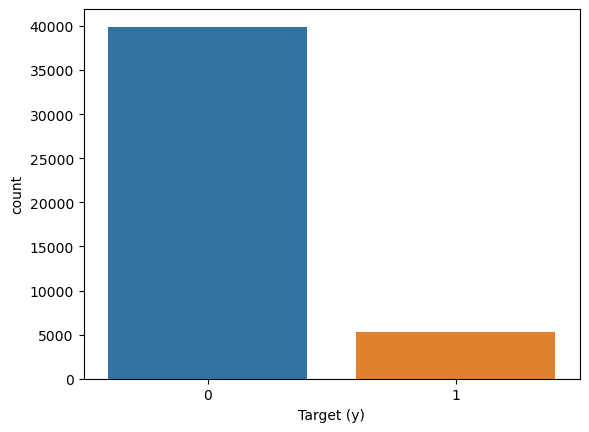

In [181]:
sns.countplot(data=df_v2, x='y')
plt.xlabel('Target (y)');

For classification problems with imbalanced datasets, it's important to consider precision, recall, and related metrics to evaluate the model's performance.

In this case, since the classification goal is to predict if the client will subscribe a term deposit, it would be better to focus on `Recall`, as we would like to correctly identify as many positive (subscribed) cases as possible, even if some negative (not subscribed) cases are incorrectly classified as positive. This is because in a marketing campaign, we would want to target those who are more likely to subscribe, and missing out on those who would subscribe would result in missed opportunities for the bank.

However, it's still important to consider precision, as we wouldn't want to falsely target those who are less likely to subscribe, as this could result in wasted resources and a poor return on investment.

For this activity, I will be focusing on `Recall` as the metric of performance.

In [15]:
df_v2.select_dtypes(include='number')

,age,default,balance,housing,loan,day,duration,campaign,pdays,previous,y
0,58,0,2143,1,0,5,261,1,-1,0,0
1,44,0,29,1,0,5,151,1,-1,0,0
2,33,0,2,1,1,5,76,1,-1,0,0
3,47,0,1506,1,0,5,92,1,-1,0,0
4,33,0,1,0,0,5,198,1,-1,0,0
...,...,...,...,...,...,...,...,...,...,...,...
45206,51,0,825,0,0,17,977,3,-1,0,1
45207,71,0,1729,0,0,17,456,2,-1,0,1
45208,72,0,5715,0,0,17,1127,5,184,3,1
45209,57,0,668,0,0,17,508,4,-1,0,0


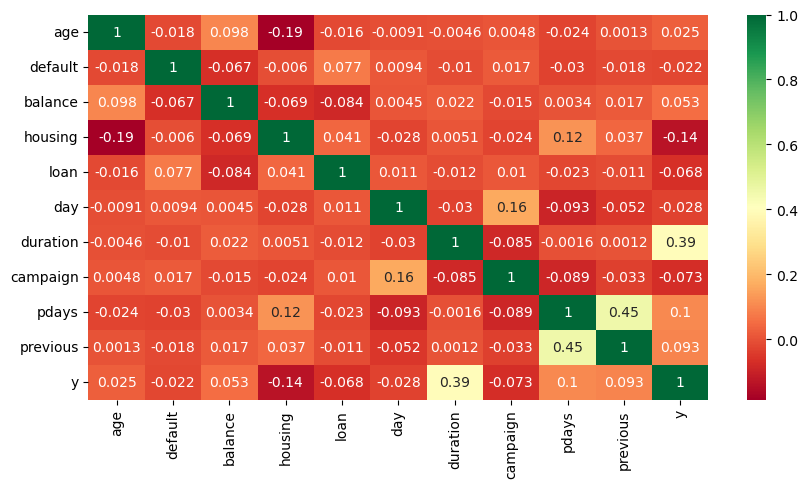

In [183]:
fig, ax = plt.subplots(figsize=(10,5))
sns.heatmap(df_v2.select_dtypes(include='number').corr(),cmap='RdYlGn',annot=True);
#No correlation of abs(>=0.7) is seen below, suggesting that multicolinearity between these features does not exist

In [17]:
df_v2.select_dtypes(include='number').columns

Index(['age', 'default', 'balance', 'housing', 'loan', 'day', 'duration',
       'campaign', 'pdays', 'previous', 'y'],
      dtype='object')

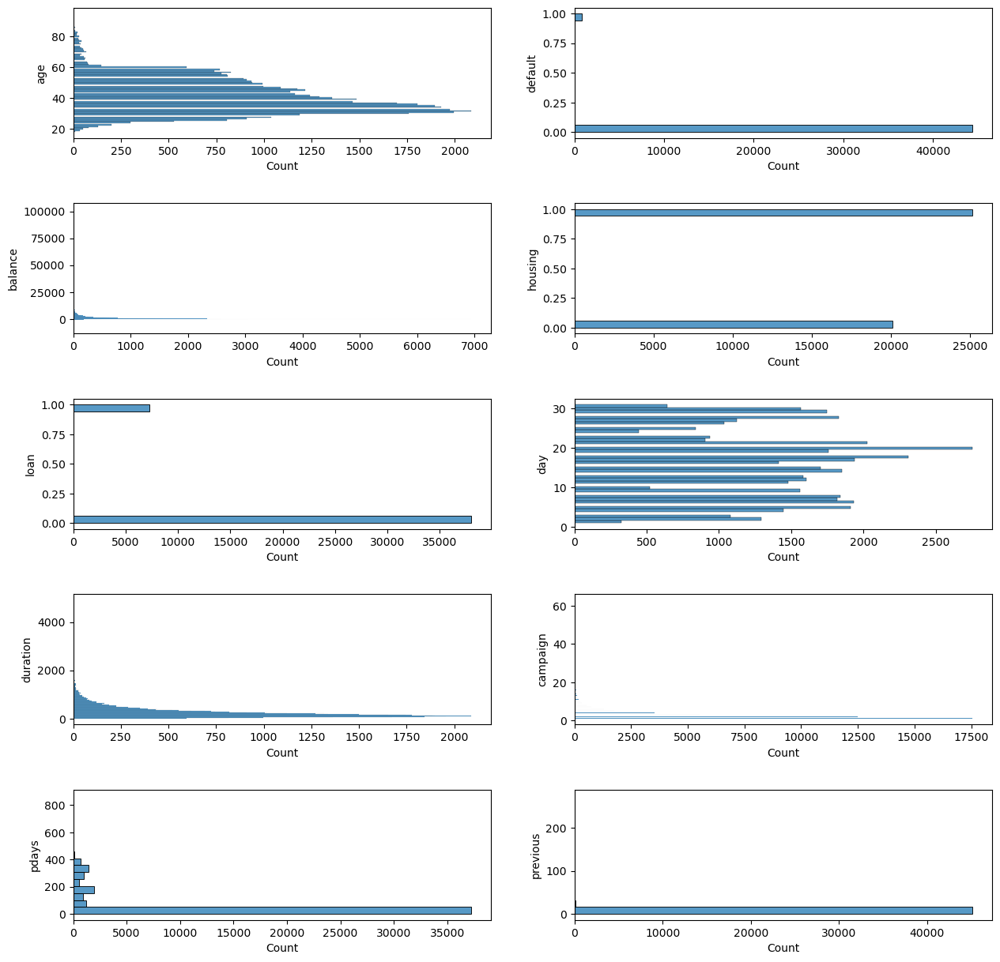

In [186]:
# Temporarily disable FutureWarning
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=FutureWarning)
    
    num_data = df_v2.select_dtypes(include='number').columns
    row = 5
    col = 2

    counter = 0
    fig, ax = plt.subplots(row,col, figsize=(15,15))
    fig.subplots_adjust(hspace=0.5)

    for i in range(row):
        for j in range(col):
            sns.histplot(data=df_v2, y=num_data[counter],label=num_data[counter], ax=ax[i,j])
            counter += 1

#Outliers can be seen on continuous numerical features.... scale!!!



In [19]:
df_v2.select_dtypes(include='string').columns

Index(['job', 'marital', 'education', 'contact', 'month', 'poutcome'], dtype='object')

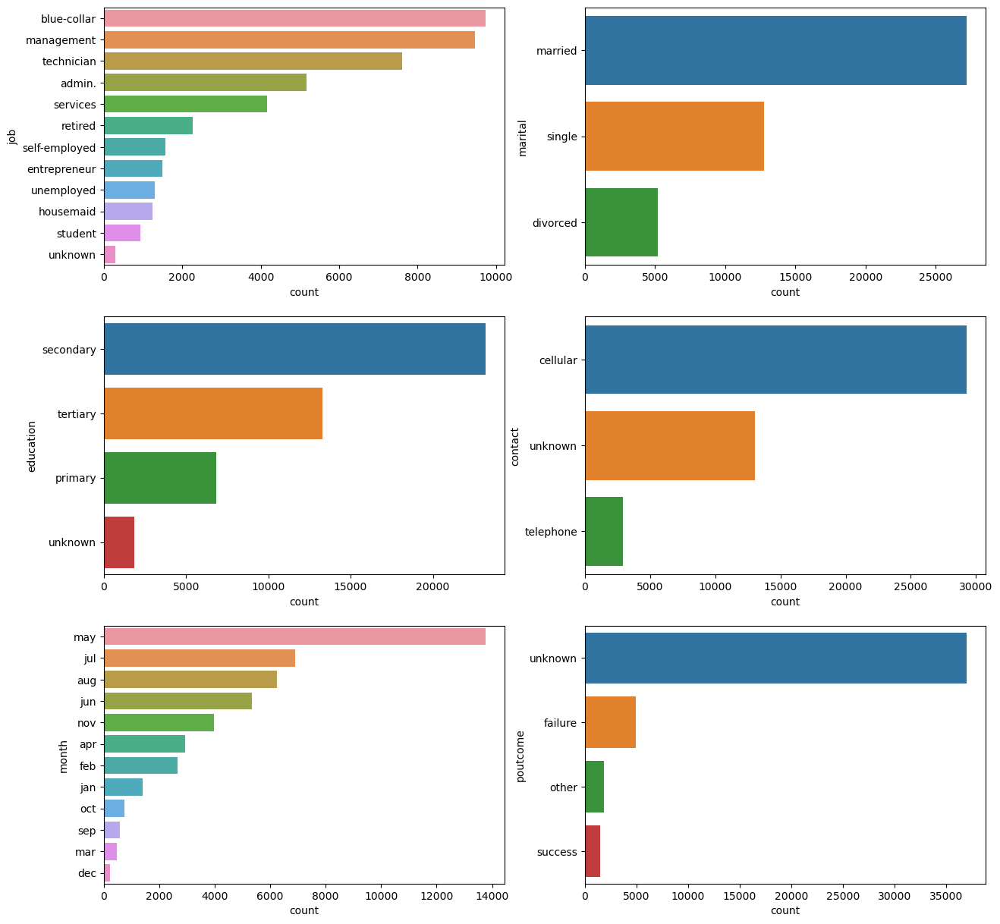

In [20]:
cat_data = df_v2.select_dtypes(include='string').columns
row = 3
col = 2

counter = 0
fig, ax = plt.subplots(row,col, figsize=(15,15))

for i in range(row):
    for j in range(col):
        order = df_v2[cat_data[counter]].value_counts().index
        sns.countplot(data=df_v2, y=cat_data[counter],label=cat_data[counter], order=order, ax=ax[i,j])
        counter += 1

#Inspect Month and poutcome as they have interesting trends
#Retain minority records that are of value `unknown`


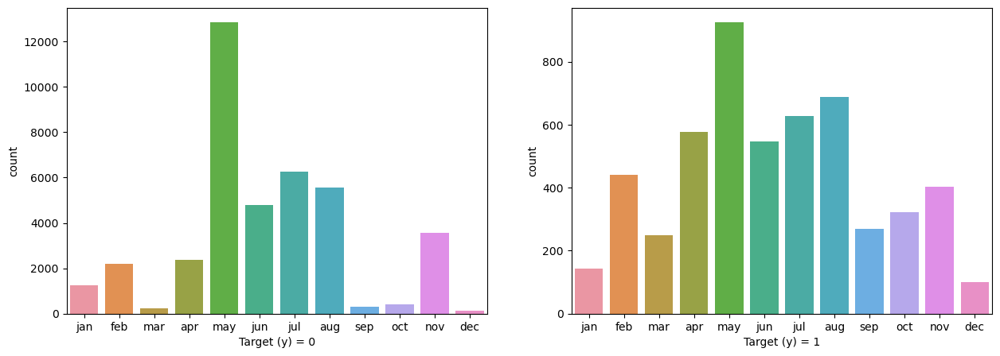

In [209]:
cat_data = df_v2.select_dtypes(include='string').columns
row = 1
col = 2
fig, ax = plt.subplots(row,col, figsize=(15,5))

for i in range(col):
#         order = df_v2[cat_data[counter]].value_counts().index
    sns.countplot(data=df_v2[df_v2['y']==i], x='month',ax=ax[i], order=['jan', 'feb', 'mar', 'apr', 'may', 'jun',
                                            'jul', 'aug', 'sep', 'oct', 'nov', 'dec'])
    ax[i].set_xlabel(f'Target (y) = {i}')

#Last contact is mostly on May. Most target value (equal 1) is also at May

Percent of data that "poutcome" results are "unknown": 81.75%


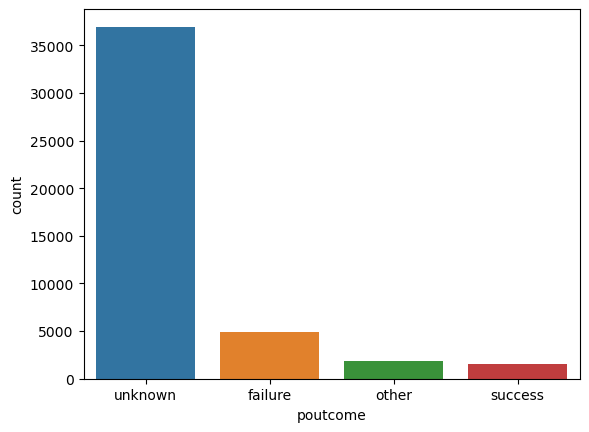

In [22]:
sns.countplot(df_v2,x='poutcome');
poutcome_per_unknown = (len(df_v2.query('poutcome=="unknown"')['poutcome'])/df_v2.shape[0])*100
print(f'Percent of data that "poutcome" results are "unknown": {poutcome_per_unknown:.2f}%')

#We can remove poutcome as it won't yield useful insights and could add noise to model training

In [23]:
#remaining categorical features
cat_val_rem= ['job', 'marital', 'education', 'contact', 'month']

In [212]:
# transform training/testing data

# Temporarily disable FutureWarning
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=FutureWarning)
    
    df_v2_check = df_v2.copy()

    X = df_v2_check.drop(columns=['y','poutcome'])
    y = df_v2_check['y']

    X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25,stratify=y,random_state=42)

    encoder_all = ce.TargetEncoder(cols=cat_val_rem)
    encoder_all.fit(X_train[cat_val_rem], y_train)
    X_train[cat_val_rem] = encoder_all.transform(X_train[cat_val_rem])
    X_test[cat_val_rem] = encoder_all.transform(X_test[cat_val_rem])
    
X_train.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous
24915,58,0.138759,0.100269,0.148690,0,0,1,0,0.148682,18,0.101689,265,1,188,1
11794,47,0.090029,0.123365,0.106641,0,287,0,0,0.040502,20,0.103906,63,1,-1,0
1279,35,0.138759,0.150146,0.148690,0,797,1,0,0.040502,8,0.066343,81,1,-1,0
913,34,0.123650,0.123365,0.106641,0,627,1,0,0.040502,7,0.066343,283,2,-1,0
5554,35,0.123650,0.150146,0.106641,0,91,1,0,0.040502,23,0.066343,185,4,-1,0


In [26]:
y_train

24915    0
11794    0
1279     0
913      0
5554     0
        ..
10010    0
26216    1
15941    0
16952    0
34781    0
Name: y, Length: 33908, dtype: int32

In [213]:
y_train.value_counts(normalize=True),y_test.value_counts(normalize=True)

(0    0.883007
 1    0.116993
 Name: y, dtype: float64,
 0    0.88304
 1    0.11696
 Name: y, dtype: float64)

In [ ]:
#Independent variable has been normally distributed between Training/Testing datasets

In [29]:
X_train.describe()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous
count,33908.0,33908.000000,33908.000000,33908.000000,33908.000000,33908.0,33908.000000,33908.000000,33908.000000,33908.0,33908.000000,33908.0,33908.0,33908.0,33908.0
mean,40.907957,0.116993,0.116993,0.116993,0.017754,1362.457709,0.557125,0.160346,0.116993,15.825233,0.116993,258.473015,2.759555,40.024979,0.582635
std,10.620338,0.044604,0.021985,0.022295,0.132058,3052.176471,0.496733,0.366932,0.048580,8.339007,0.082067,258.936344,3.09406,100.018015,2.445884
min,18.0,0.071923,0.100269,0.087065,0.000000,-8019.0,0.000000,0.000000,0.040502,1.0,0.066343,0.0,1.0,-1.0,0.0
25%,33.0,0.087344,0.100269,0.106641,0.000000,74.0,0.000000,0.000000,0.040502,8.0,0.066343,103.0,1.0,-1.0,0.0
50%,39.0,0.109447,0.100269,0.106641,0.000000,451.0,1.000000,0.000000,0.148682,16.0,0.101689,180.0,2.0,-1.0,0.0
75%,48.0,0.138759,0.150146,0.148690,0.000000,1432.0,1.000000,0.000000,0.148682,21.0,0.110612,318.0,3.0,-1.0,0.0
max,95.0,0.294366,0.150146,0.148690,1.000000,102127.0,1.000000,1.000000,0.148682,31.0,0.502762,4918.0,63.0,871.0,275.0


In [30]:
#Scale as dependent variables are non-standardized
scaler = StandardScaler().fit(X_train)
X_train_scaled_arr = scaler.transform(X_train)
X_train_scaled = pd.DataFrame(X_train_scaled_arr, columns=X_train.columns, index=X_train.index)

X_test_scaled_arr = scaler.transform(X_test)
X_test_scaled = pd.DataFrame(X_test_scaled_arr, columns=X_test.columns, index=X_test.index)

X_train_scaled.describe()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous
count,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04,3.390800e+04
mean,-3.277365e-16,1.521334e-16,2.824736e-16,6.454145e-17,-6.412235e-17,-4.012886e-17,8.759197e-17,-1.215391e-17,2.447546e-16,5.762630e-17,1.028106e-16,3.331848e-17,9.717889e-18,1.592581e-17,5.133979e-17
std,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00
min,-2.157021e+00,-1.010470e+00,-7.607076e-01,-1.342417e+00,-1.344426e-01,-3.073740e+00,-1.121595e+00,-4.369968e-01,-1.574567e+00,-1.777844e+00,-6.171822e-01,-9.982254e-01,-5.686966e-01,-4.101819e-01,-2.382141e-01
25%,-7.446160e-01,-6.647294e-01,-7.607076e-01,-4.643186e-01,-1.344426e-01,-4.221501e-01,-1.121595e+00,-4.369968e-01,-1.574567e+00,-9.384029e-01,-6.171822e-01,-6.004383e-01,-5.686966e-01,-4.101819e-01,-2.382141e-01
50%,-1.796539e-01,-1.691909e-01,-7.607076e-01,-4.643186e-01,-1.344426e-01,-2.986299e-01,8.915878e-01,-4.369968e-01,6.523101e-01,2.095808e-02,-1.864822e-01,-3.030636e-01,-2.454919e-01,-4.101819e-01,-2.382141e-01
75%,6.677893e-01,4.879850e-01,1.508010e+00,1.421725e+00,-1.344426e-01,2.278483e-02,8.915878e-01,-4.369968e-01,6.523101e-01,6.205587e-01,-7.775623e-02,2.298938e-01,7.771288e-02,-4.101819e-01,-2.382141e-01
max,5.093326e+00,3.976698e+00,1.508010e+00,1.421725e+00,7.438117e+00,3.301448e+01,8.915878e-01,2.288346e+00,6.523101e-01,1.819760e+00,4.700720e+00,1.799514e+01,1.947000e+01,8.308376e+00,1.121972e+02


In [31]:
X_train.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays',
       'previous'],
      dtype='object')

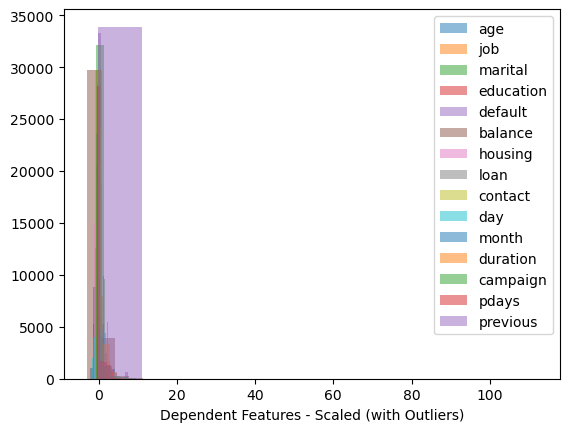

In [220]:
for i in X_train.columns:
#     plt.hist(df_v2_check.query('y==1')[i],alpha=0.5,bins=20,label=i)
    plt.hist(data=X_train_scaled, x=i, label=i, alpha=0.5)
#     plt.plot()

plt.legend()
plt.xlabel('Dependent Features - Scaled (with Outliers)');

#It appears that there are outliers in this scaled dataset.. Zoom in.


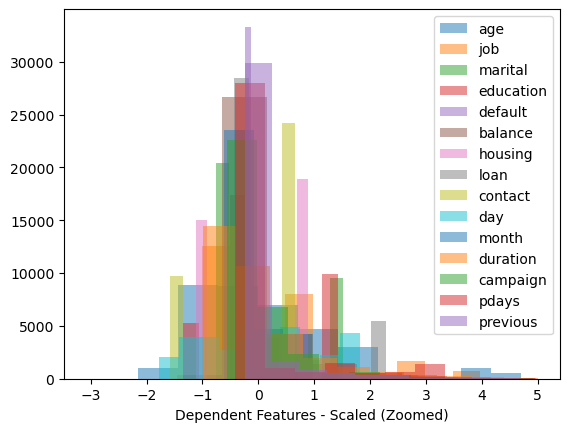

In [221]:
#Zooming in if boundary is +/- 5 std (sigma)
for i in X_train.columns:
#     plt.hist(df_v2_check.query('y==1')[i],alpha=0.5,bins=20,label=i)
    plt.hist(data=X_train_scaled[(X_train_scaled[i]<=5) & (X_train_scaled[i]>=-5)], x=i, label=i, alpha=0.5)
#     plt.plot()

plt.legend()
plt.xlabel('Dependent Features - Scaled (Zoomed)');

    
## Confirmed that there are outliers but at 0 std (sigma), looks like most dependent features are normally distributed.

There are two (2) considerations that I have for outliers:

1. Log-transform the data
    - Simplier
    - Could lose data after transformation
2. Determine the outliers and trim accordingly
    - Complex
    - To lose data after trimming
    
#### Perform Log-transform!

In [217]:
#Log to improve performance - Outlier Cleanup
X_train_scaled_logged = X_train_scaled.copy()
X_test_scaled_logged = X_test_scaled.copy()
for i in X_train.columns:
    X_train_scaled_logged[i] = np.log(X_train_scaled_logged[i]+2)
    
for i in X_test.columns:
    X_test_scaled_logged[i] = np.log(X_test_scaled_logged[i]+2)

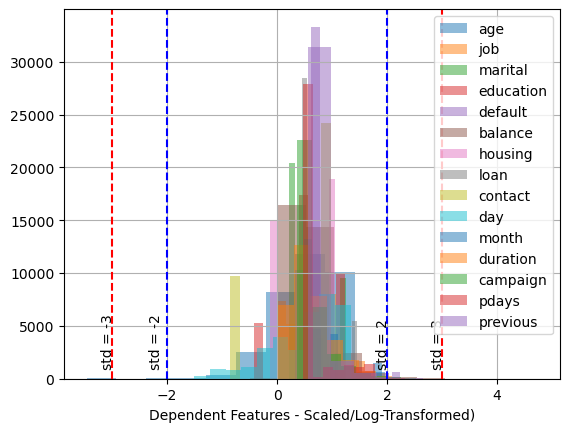

In [232]:
for i in X_train.columns:
#     plt.hist(df_v2_check.query('y==1')[i],alpha=0.5,bins=20,label=i)
    plt.hist(data=X_train_scaled_logged[(X_train_scaled_logged[i]<=5) & (X_train_scaled_logged[i]>=-5)], x=i, label=i, alpha=0.5)
#     plt.plot()

plt.legend()

plt.axvline(x=-3,color='r',linestyle='--')
plt.text(-3.2, 0.5, '   std = -3', rotation=90)

plt.axvline(x=-2,color='blue',linestyle='--')
plt.text(-2.2, 0.5, '   std = -2', ha='center', rotation=90)

plt.axvline(x=2,color='blue',linestyle='--')
plt.text(1.8, 0.5, '   std = 2', rotation=90)

plt.axvline(x=3,color='r',linestyle='--')
plt.text(2.8, 0.5, '   std = 3', rotation=90)

plt.grid()
plt.xlabel('Dependent Features - Scaled/Log-Transformed)');


In [37]:
X_train_scaled_logged.describe()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous
count,33874.000000,33908.000000,33908.000000,33908.000000,33908.000000,33906.000000,33908.000000,33908.000000,33908.000000,33908.000000,33908.000000,33908.000000,33908.000000,33908.000000,33908.000000
mean,0.554422,0.591339,0.578619,0.555813,0.652342,0.636126,0.534141,0.608445,0.445117,0.525015,0.621097,0.609581,0.625344,0.615977,0.654823
std,0.566588,0.439305,0.464937,0.543795,0.214091,0.293337,0.591834,0.370341,0.824671,0.639273,0.336059,0.379650,0.327471,0.348360,0.233376
min,-3.464157,-0.010525,0.214541,-0.419185,0.623560,-1.494461,-0.129647,0.446609,-0.854648,-1.504374,0.324123,0.001773,0.358585,0.463620,0.566328
25%,0.227441,0.289134,0.214541,0.428974,0.623560,0.456063,-0.129647,0.446609,-0.854648,0.059775,0.324123,0.336159,0.358585,0.463620,0.566328
50%,0.599027,0.604758,0.214541,0.428974,0.623560,0.531434,1.061806,0.446609,0.975431,0.703572,0.595268,0.528825,0.562189,0.463620,0.566328
75%,0.981250,0.911473,1.255049,1.230145,0.623560,0.704475,1.061806,0.446609,0.975431,0.963388,0.653493,0.801954,0.731268,0.463620,0.566328
max,1.959154,1.787868,1.255049,1.230145,2.244756,3.555762,1.061806,1.455901,0.975431,1.340188,1.902215,2.995489,3.066657,2.332957,4.737927


In [38]:
X_test_scaled_logged.describe()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous
count,11290.000000,11303.000000,11303.000000,11303.000000,11303.000000,11303.000000,11303.000000,11303.000000,11303.000000,11303.000000,11303.000000,11303.000000,11303.000000,11303.000000,11303.000000
mean,0.558553,0.597567,0.582559,0.570308,0.654111,0.635596,0.528008,0.607964,0.437150,0.521396,0.619925,0.608706,0.626865,0.618802,0.656165
std,0.577940,0.434413,0.466049,0.537460,0.220453,0.295096,0.592525,0.369906,0.828371,0.638137,0.335250,0.377282,0.330680,0.350346,0.229885
min,-3.464157,-0.010525,0.214541,-0.419185,0.623560,-0.801172,-0.129647,0.446609,-0.854648,-1.504374,0.324123,0.001773,0.358585,0.463620,0.566328
25%,0.227441,0.289134,0.214541,0.428974,0.623560,0.454608,-0.129647,0.446609,-0.854648,0.059775,0.324123,0.337537,0.358585,0.463620,0.566328
50%,0.599027,0.604758,0.214541,0.428974,0.623560,0.529120,1.061806,0.446609,0.975431,0.703572,0.595268,0.526546,0.562189,0.463620,0.566328
75%,1.015937,0.911473,1.255049,1.230145,0.623560,0.700336,1.061806,0.446609,0.975431,0.963388,0.653493,0.808858,0.731268,0.463620,0.566328
max,1.932247,1.787868,1.255049,1.230145,2.244756,3.520429,1.061806,1.455901,0.975431,1.340188,1.902215,2.639150,2.938334,2.300426,2.826690


In [39]:
# X_train_scaled_logged
# y_train

# X_test_scaled_logged
# y_test

#Check if there are no nulls after normalization

In [40]:
X_train_scaled_logged.isnull().sum()

age          34
job           0
marital       0
education     0
default       0
balance       2
housing       0
loan          0
contact       0
day           0
month         0
duration      0
campaign      0
pdays         0
previous      0
dtype: int64

In [41]:
X_test_scaled_logged.isnull().sum()

age          13
job           0
marital       0
education     0
default       0
balance       0
housing       0
loan          0
contact       0
day           0
month         0
duration      0
campaign      0
pdays         0
previous      0
dtype: int64

In [42]:
X_train_scaled_logged_v1 = X_train_scaled_logged.copy()
X_test_scaled_logged_v1 = X_test_scaled_logged.copy()
y_train_v1 = y_train.copy()
y_test_v1 = y_test.copy()

In [43]:
#Remove Null values after Normalization
mask_train1 = X_train_scaled_logged_v1['age'].isnull()
mask_train2 = X_train_scaled_logged_v1['balance'].isnull()
train_todrop1 = X_train_scaled_logged_v1[mask_train1].index
train_todrop2 = X_train_scaled_logged_v1[mask_train2].index
train_todrop = train_todrop1.union(train_todrop2)

mask_test = X_test_scaled_logged_v1['age'].isnull()
test_todrop = X_test_scaled_logged_v1[mask_test].index

In [44]:
len(train_todrop), len(test_todrop)

(36, 13)

In [45]:
print(f'X_train length before drop: {len(X_train_scaled_logged_v1)}')
print(f'X_test length before drop: {len(X_test_scaled_logged_v1)}')
print(f'y_train length before drop: {len(y_train_v1)}')
print(f'y_test length before drop: {len(y_test_v1)}')

X_train length before drop: 33908
X_test length before drop: 11303
y_train length before drop: 33908
y_test length before drop: 11303


In [46]:
X_train_scaled_logged_v1.drop(train_todrop, inplace=True)
y_train_v1.drop(index=train_todrop, inplace=True)

X_test_scaled_logged_v1.drop(test_todrop, inplace=True)
y_test_v1.drop(index=test_todrop, inplace=True)

In [47]:
print(f'X_train length after drop: {len(X_train_scaled_logged_v1)}')
print(f'X_test length after drop: {len(X_test_scaled_logged_v1)}')
print(f'y_train length after drop: {len(y_train_v1)}')
print(f'y_test length after drop: {len(y_test_v1)}')

X_train length after drop: 33872
X_test length after drop: 11290
y_train length after drop: 33872
y_test length after drop: 11290


## Modeling

In [48]:
#Recheck data

X_train_v2 = X_train_scaled_logged_v1.copy()
X_test_v2 = X_test_scaled_logged_v1.copy()
y_train_v2 = y_train_v1.copy()
y_test_v2 = y_test_v1.copy()

X_train_v2.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous
24915,1.283540,0.911473,0.214541,1.230145,0.62356,0.440578,1.061806,0.446609,0.975431,0.815718,0.595268,0.705672,0.358585,1.24689,0.775023
11794,0.945317,0.333230,0.828479,0.428974,0.62356,0.499342,-0.129647,0.446609,-0.854648,0.916546,0.610053,0.219201,0.358585,0.46362,0.566328
1279,0.367213,0.911473,1.255049,1.230145,0.62356,0.595939,1.061806,0.446609,-0.854648,0.059775,0.324123,0.273530,0.358585,0.46362,0.566328
913,0.299767,0.765122,0.828479,0.428974,0.62356,0.564765,1.061806,0.446609,-0.854648,-0.060093,0.324123,0.739422,0.562189,0.46362,0.566328
5554,0.367213,0.765122,1.255049,0.428974,0.62356,0.459587,1.061806,0.446609,-0.854648,1.050961,0.324123,0.540140,0.875851,0.46362,0.566328


#### Model/Training to be used:

<br>

- Model
    1. LogisticRegression
    2. SGD Classifier
    3. KNeighborsClassifier
    4. DecisionTree
    5. SVC

<br>

- Optimization Method
    1. HalvingRandomSearchCV (faster option)
    2. GridSearchCV (slower option)


Note: I have tried to use GridSearchCV to check if this will affect performance for larger dataset out of curiousity


#### Model Training using HalvingRandomSearchCV Optimization

In [50]:
#LogisticRegression with HalvingRandomSearchCV
pipe1_hrd = Pipeline([
    ('model', LogisticRegression()),
])

param1_hrd = {
    'model__penalty': ['l1', 'l2'],
    'model__C': [0.001, 0.01, 0.1, 1, 10, 100],
    'model__multi_class' : ['auto', 'ovr', 'multinomial'],
    'model__max_iter': [100, 1000, 10000],
    'model__fit_intercept': [True,False]
}
    
opti1_hrd  = HalvingRandomSearchCV(
    estimator=pipe1_hrd ,
    param_distributions= param1_hrd,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)


In [51]:
#SGD Classifier with HalvingRandomSearchCV
pipe2_hrd = Pipeline([
    ('model', SGDClassifier(max_iter=10000)),
])
    
param2_hrd = {
    'model__loss': ['hinge', 'log_loss', 'modified_huber', 'squared_hinge', 'perceptron'],
    'model__penalty': ['l2', 'l1', 'elasticnet'],
    'model__alpha': [0.0001, 0.001, 0.01, 0.1],
    'model__learning_rate': ['constant', 'optimal', 'invscaling', 'adaptive'],
}

opti2_hrd = HalvingRandomSearchCV(
    estimator=pipe2_hrd,
    param_distributions= param2_hrd,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)


In [52]:
#KNeighborsClassifier with HalvingRandomSearchCV
pipe3_hrd = Pipeline([
    ('model', KNeighborsClassifier()),
])

param3_hrd = {
    'model__n_neighbors': [3, 5, 7, 9, 11],
    'model__weights': ['uniform', 'distance'],
    'model__algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'model__leaf_size': [10, 20, 30, 40, 50],
}
    
opti3_hrd = HalvingRandomSearchCV(
    estimator=pipe3_hrd,
    param_distributions= param3_hrd,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)


In [53]:
#DecisionTreeClassifier with HalvingRandomSearchCV
pipe4_hrd = Pipeline([
    ('model', DecisionTreeClassifier(random_state=42)),
])

param4_hrd = {
    'model__criterion': ['gini', 'entropy'],
    'model__max_depth': [5, 10, 20, 50],
    'model__min_samples_split': [2, 5, 10, 20],
    'model__min_samples_leaf': [1, 2, 4],
    'model__max_leaf_nodes': [5, 10, 20],
}
 
opti4_hrd = HalvingRandomSearchCV(
    estimator=pipe4_hrd,
    param_distributions= param4_hrd,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)


In [54]:
#SVC with HalvingRandomSearchCV
pipe5_hrd = Pipeline([
    ('model', SVC(random_state=42)),
])

param5_hrd = {
    'model__kernel': ['linear', 'poly', 'rbf', 'sigmoid'], #Reduced params grid variables to speed up searching process..
}



opti5_hrd = HalvingRandomSearchCV(
    estimator=pipe5_hrd,
    param_distributions= param5_hrd,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)



In [56]:
%%capture
%%time
start_time1 = time.time()
opti1_hrd.fit(X_train_v2,y_train_v2)
end_time1 = time.time()
dur_time1 = end_time1 - start_time1

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:305: UserWarning: The total space of parameters 216 is smaller than n_iter=338. Running 216 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _sco

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  Fil

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/m

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
300 fits failed out of a total of 600.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
300 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\pipeline.py", line 405, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packag

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

CPU times: total: 2min 25s
Wall time: 2min 2s


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

In [57]:
%%capture
%%time
start_time2 = time.time()
opti2_hrd.fit(X_train_v2,y_train_v2)
end_time2 = time.time()
dur_time2 = end_time2 - start_time2

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:305: UserWarning: The total space of parameters 240 is smaller than n_iter=338. Running 240 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _sco

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
1300 fits failed out of a total of 2000.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1300 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\pipeline.py", line 405, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-pac

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
175 fits failed out of a total of 225.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
175 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\pipeline.py", line 405, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packag

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
25 fits failed out of a total of 75.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
25 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\pipeline.py", line 405, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\

CPU times: total: 1min 15s
Wall time: 1min 12s


In [58]:
%%capture
%%time
start_time3 = time.time()
opti3_hrd.fit(X_train_v2,y_train_v2)
end_time3 = time.time()
dur_time3 = end_time3 - start_time3

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:305: UserWarning: The total space of parameters 200 is smaller than n_iter=338. Running 200 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _sco

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan]
  warnings.warn(


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

CPU times: total: 6min 38s
Wall time: 6min 13s


In [59]:
%%capture
%%time
start_time4 = time.time()
opti4_hrd.fit(X_train_v2,y_train_v2)
end_time4 = time.time()
dur_time4 = end_time4 - start_time4

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:305: UserWarning: The total space of parameters 288 is smaller than n_iter=338. Running 288 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _sco

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

CPU times: total: 2min 1s
Wall time: 2min 46s


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

In [60]:
%%capture
%%time
start_time5 = time.time()
opti5_hrd.fit(X_train_v2,y_train_v2)
end_time5 = time.time()
dur_time5 = end_time5 - start_time5

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:305: UserWarning: The total space of parameters 4 is smaller than n_iter=338. Running 4 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
 

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

CPU times: total: 40.8 s
Wall time: 42.8 s


In [62]:
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)


In [63]:
#Modeling Results:



mod_results_randcv = {
    'Model': ['LogisticRegression', "SGDClassifier", "KNeighborsClassifier", "DecisionTreeClassifier", 'SVC'],
    'Best Params': [opti.best_params_ for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'Accuracy Score' : [accuracy_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'Precision Score' : [precision_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'Recall Score' : [recall_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'F1 Score' : [f1_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'ROC AUC Score': [opti.best_score_ for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'Time' : ["2min 2s", "1min 12s", "6min 13s", "2min 46s", "42.8 s"]
}

df_res = pd.DataFrame(mod_results_randcv).set_index('Model')
df_res

,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,Time
Model,,,,,,
LogisticRegression,"{'model__penalty': 'l2', 'model__multi_class': 'ovr', 'model__max_iter': 10000, 'model__fit_intercept': True, 'model__C': 0.1}",0.893977,0.597134,0.284306,0.385208,1min 22s
SGDClassifier,"{'model__penalty': 'l2', 'model__loss': 'log_loss', 'model__learning_rate': 'optimal', 'model__alpha': 0.0001}",0.891851,0.555936,0.369219,0.443736,58.4s
KNeighborsClassifier,"{'model__weights': 'distance', 'model__n_neighbors': 11, 'model__leaf_size': 40, 'model__algorithm': 'ball_tree'}",0.893977,0.604452,0.267627,0.370993,2min 57s
DecisionTreeClassifier,"{'model__min_samples_split': 10, 'model__min_samples_leaf': 4, 'model__max_leaf_nodes': 20, 'model__max_depth': 50, 'model__criterion': 'entropy'}",0.886891,0.519266,0.429113,0.469905,1min 25s
SVC,{'model__kernel': 'rbf'},0.896103,0.660088,0.228203,0.339155,33.7 s


#### Model Training using GridSearchCVOptimization

In [64]:
#LogisticRegression with GridSearchCV
pipe1_gcv = Pipeline([
    ('model', LogisticRegression()),
])

param1_gcv = {
    'model__penalty': ['l1', 'l2'],
    'model__C': [0.001, 0.01, 0.1, 1, 10, 100],
    'model__multi_class' : ['auto', 'ovr', 'multinomial'],
    'model__max_iter': [100, 1000, 10000],
    'model__fit_intercept': [True,False]
}
    
opti1_gcv  = GridSearchCV(
    estimator=pipe1_gcv ,
    param_grid=param1_gcv,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)


In [65]:
#SGD Classifier with GridSearchCV
pipe2_gcv = Pipeline([
    ('model', SGDClassifier(max_iter=50000)),
])
    
param2_gcv = {
    'model__loss': ['hinge', 'log_loss', 'modified_huber', 'squared_hinge', 'perceptron'],
    'model__penalty': ['l2', 'l1', 'elasticnet'],
    'model__alpha': [0.0001, 0.001, 0.01, 0.1],
    'model__learning_rate': ['constant', 'optimal', 'invscaling', 'adaptive'],
}

opti2_gcv  = GridSearchCV(
    estimator=pipe2_gcv ,
    param_grid=param2_gcv,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)



In [66]:
#KNeighborsClassifier with GridSearchCV
pipe3_gcv = Pipeline([
    ('model', KNeighborsClassifier()),
])

param3_gcv = {
    'model__n_neighbors': [3, 5, 7, 9, 11],
    'model__weights': ['uniform', 'distance'],
    'model__algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'model__leaf_size': [10, 20, 30, 40, 50],
}
    
opti3_gcv  = GridSearchCV(
    estimator=pipe3_gcv ,
    param_grid=param3_gcv,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)


In [67]:
#DecisionTreeClassifier with GridSearchCV
pipe4_gcv = Pipeline([
    ('model', DecisionTreeClassifier(random_state=42)),
])

param4_gcv = {
    'model__criterion': ['gini', 'entropy'],
    'model__max_depth': [5, 10, 20, 50],
    'model__min_samples_split': [2, 5, 10, 20],
    'model__min_samples_leaf': [1, 2, 4],
    'model__max_leaf_nodes': [5, 10, 20],
}
 
opti4_gcv  = GridSearchCV(
    estimator=pipe4_gcv ,
    param_grid=param4_gcv,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)



In [87]:
#SVC with GridSearchCV
pipe5_gcv = Pipeline([
    ('model', SVC(random_state=42)),
])

param5_gcv = {
    'model__kernel': ['linear', 'poly', 'rbf', 'sigmoid']
    #Reduced params grid variables to speed up searching process..
}

opti5_gcv  = GridSearchCV(
    estimator=pipe5_gcv,
    param_grid=param5_gcv,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)

In [69]:
%%capture
%%time
start_time1_gcv = time.time()
opti1_gcv.fit(X_train_v2,y_train_v2)
end_time1_gcv = time.time()
dur_time1_gcv = end_time1_gcv - start_time1_gcv


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
2700 fits failed out of a total of 5400.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2700 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\pipeline.py", line 405, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-pac

CPU times: total: 17min 19s
Wall time: 9min 18s


In [70]:
%%capture
%%time
start_time2_gcv = time.time()
opti2_gcv.fit(X_train_v2,y_train_v2)
end_time2_gcv = time.time()
dur_time2_gcv = end_time2_gcv - start_time2_gcv


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasin

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasin

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasin

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasin

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\linear_model\_stochastic_gradient.py:702: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasin

CPU times: total: 9h 38min 11s
Wall time: 9h 45min 26s


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
4500 fits failed out of a total of 6000.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
4500 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\pipeline.py", line 405, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-pac

In [71]:
%%capture
%%time
start_time3_gcv = time.time()
opti3_gcv.fit(X_train_v2,y_train_v2)
end_time3_gcv = time.time()
dur_time3_gcv = end_time3_gcv - start_time3_gcv


CPU times: total: 1h 32min 7s
Wall time: 1h 24min 18s


In [72]:
%%capture
%%time
start_time4_gcv = time.time()
opti4_gcv.fit(X_train_v2,y_train_v2)
end_time4_gcv = time.time()
dur_time4_gcv = end_time4_gcv - start_time4_gcv


CPU times: total: 9min 45s
Wall time: 9min 46s


In [88]:
%%capture
%%time
start_time5_gcv = time.time()
opti5_gcv.fit(X_train_v2,y_train_v2)
end_time5_gcv = time.time()
dur_time5_gcv = end_time5_gcv - start_time5_gcv


CPU times: total: 42min 10s
Wall time: 42min 14s


In [95]:
#Modeling Results1:



mod_results_randcv = {
    'Model': ['LogisticRegression', "SGDClassifier", "KNeighborsClassifier", "DecisionTreeClassifier", 'SVC'],
    'Best Params': [opti.best_params_ for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'Accuracy Score' : [accuracy_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'Precision Score' : [precision_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'Recall Score' : [recall_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'F1 Score' : [f1_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'ROC AUC Score': [opti.best_score_ for opti in [opti1_hrd, opti2_hrd, opti3_hrd, opti4_hrd, opti5_hrd]],
    'Time' : ["2min 2s", "1min 12s", "6min 13s", "2min 46s", "42.8 s"]
}

df_res = pd.DataFrame(mod_results_randcv).set_index('Model')
df_res

,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,ROC AUC Score,Time
Model,,,,,,,
LogisticRegression,"{'model__penalty': 'l2', 'model__multi_class': 'ovr', 'model__max_iter': 10000, 'model__fit_intercept': True, 'model__C': 0.1}",0.893977,0.597134,0.284306,0.385208,0.897295,2min 2s
SGDClassifier,"{'model__penalty': 'l2', 'model__loss': 'log_loss', 'model__learning_rate': 'optimal', 'model__alpha': 0.0001}",0.891851,0.555936,0.369219,0.443736,0.893304,1min 12s
KNeighborsClassifier,"{'model__weights': 'distance', 'model__n_neighbors': 11, 'model__leaf_size': 40, 'model__algorithm': 'ball_tree'}",0.893977,0.604452,0.267627,0.370993,0.849107,6min 13s
DecisionTreeClassifier,"{'model__min_samples_split': 10, 'model__min_samples_leaf': 4, 'model__max_leaf_nodes': 20, 'model__max_depth': 50, 'model__criterion': 'entropy'}",0.886891,0.519266,0.429113,0.469905,0.891205,2min 46s
SVC,{'model__kernel': 'rbf'},0.896103,0.660088,0.228203,0.339155,NaN,42.8 s


In [236]:
#Modeling Results2:
mod_results_gridcv = {
    'Model': ['LogisticRegression', "SGDClassifier", "KNeighborsClassifier", "DecisionTreeClassifier", 'SVC'],
    'Best Params': [opti.best_params_ for opti in [opti1_gcv, opti2_gcv, opti3_gcv, opti4_gcv, opti5_gcv]],
    'Accuracy Score' : [accuracy_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_gcv, opti2_gcv, opti3_gcv, opti4_gcv, opti5_gcv]],
    'Precision Score' : [precision_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_gcv, opti2_gcv, opti3_gcv, opti4_gcv, opti5_gcv]],
    'Recall Score' : [recall_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_gcv, opti2_gcv, opti3_gcv, opti4_gcv,opti5_gcv ]],
    'F1 Score' : [f1_score(y_test_v2, opti.predict(X_test_v2)) for opti in [opti1_gcv, opti2_gcv, opti3_gcv, opti4_gcv, opti5_gcv]],
    'ROC AUC Score': [opti.best_score_ for opti in [opti1_gcv, opti2_gcv, opti3_gcv, opti4_gcv, opti5_gcv]],
    'Time' : ["9min 18s", "9h 45min 26s", "1h 24min 18s", "9min 46s", "42min 14s"]
}

df_res2 = pd.DataFrame(mod_results_gridcv).set_index('Model')
df_res2

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,ROC AUC Score,Time
Model,,,,,,,
LogisticRegression,"{'model__C': 100, 'model__fit_intercept': True, 'model__max_iter': 100, 'model__multi_class': 'auto', 'model__penalty': 'l2'}",0.894331,0.596330,0.295679,0.395337,0.897641,9min 18s
SGDClassifier,"{'model__alpha': 0.01, 'model__learning_rate': 'optimal', 'model__loss': 'modified_huber', 'model__penalty': 'l2'}",0.890788,0.606965,0.184989,0.283556,0.897741,9h 45min 26s
KNeighborsClassifier,"{'model__algorithm': 'auto', 'model__leaf_size': 10, 'model__n_neighbors': 11, 'model__weights': 'distance'}",0.893977,0.604452,0.267627,0.370993,0.866219,1h 24min 18s
DecisionTreeClassifier,"{'model__criterion': 'entropy', 'model__max_depth': 10, 'model__max_leaf_nodes': 20, 'model__min_samples_leaf': 1, 'model__min_samples_split': 2}",0.886891,0.519266,0.429113,0.469905,0.891777,9min 46s
SVC,{'model__kernel': 'linear'},0.883171,0.000000,0.000000,0.000000,0.892118,42min 14s


#### Notes:

1. We are looking at the highest value of `Recall` - which can be seen using a `DecisionTree` model
2. The values from both optimization functions did not have much significant difference
3. HalvingRandomSearchCV was able to get the optimal values in a relatively fast rate compared with GridSearchCV
4. I have not disabled the warnings in this section to review and significant errors and rectify them accordingly
5. During HalvingRandomSearchCV fitting, it produced several errors related to scoring
    - Note 1: This was a result mostly of using the scoring metric as `roc-auc`
    - Note 2: I have displayed all metrics as a way to compare values between trained models
6. During GridSearchCV fitting, it produced several errors related to fit warnings and max_iter
    - Note 1: This could be somehow related to the rate/way at which the model converges  
    - Note 2: I have displayed all metrics as a way to compare values between trained models
7. With SVC optimized by HalvingRandomSearchCV, `ROC AUC was valued NaN`
8. With SVC optimized by GridSearchCV, `Precision, Recall, and F1 were valued 0`
9. The goal is to make the project as simple as possible while yielding to high `Recall` score related to the Business Goal   
    
    
#### Primary Result - Use Decision Tree!

In [240]:
opti4_hrd

HalvingRandomSearchCV(cv=25,
                      estimator=Pipeline(steps=[('model',
                                                 DecisionTreeClassifier(random_state=42))]),
                      param_distributions={'model__criterion': ['gini',
                                                                'entropy'],
                                           'model__max_depth': [5, 10, 20, 50],
                                           'model__max_leaf_nodes': [5, 10, 20],
                                           'model__min_samples_leaf': [1, 2, 4],
                                           'model__min_samples_split': [2, 5,
                                                                        10,
                                                                        20]},
                      scoring='roc_auc')

#### Optimize Best Model 

In [254]:
print(f'Best Parameters: {opti4_hrd.best_params_}')
print(f'')
print(f'Best Recall Score: {recall_score(y_test_v2, opti4_hrd.predict(X_test_v2))}')

Best Parameters: {'model__min_samples_split': 10, 'model__min_samples_leaf': 4, 'model__max_leaf_nodes': 20, 'model__max_depth': 50, 'model__criterion': 'entropy'}

Best Recall Score: 0.4291129643669447


In [253]:
print(f'Best Parameters: {opti4_gcv.best_params_}')
print(f'')
print(f'Best Recall Score: {recall_score(y_test_v2, opti4_gcv.predict(X_test_v2))}')

Best Parameters: {'model__criterion': 'entropy', 'model__max_depth': 10, 'model__max_leaf_nodes': 20, 'model__min_samples_leaf': 1, 'model__min_samples_split': 2}

Best Recall Score: 0.4291129643669447


In [ ]:
#Relatively low at the moment...
#Recreate the model

In [261]:
#DecisionTreeClassifier with HalvingRandomSearchCV - using ROS
pipe_opt = Pipeline([
    ('model', DecisionTreeClassifier(random_state=42)),
])

#update the hyperparameters
param_opt = {
    'model__criterion': ['gini', 'entropy'],
    'model__max_depth': [10, 30, 50, 70, 90, 110],
    'model__min_samples_split': [2, 5, 10, 30, 50, 70, 90],
    'model__min_samples_leaf': [1, 2, 4, 6, 8, 10, 12, 14, 16, 18],
    'model__max_leaf_nodes': [30, 40, 50, 60, 70, 80, 90, 100],
    'model__class_weight': [None, 'balanced'],
    'model__splitter': ['best', 'random'],
    'model__ccp_alpha': [0.0, 0.1, 0.5]   
}

opt_hrd = HalvingRandomSearchCV(
    estimator=pipe_opt,
    param_distributions= param_opt,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)


In [262]:
#Perform resampling techniques to training datasets

# RandomOverSampler class randomly duplicates samples from the minority class to balance the dataset
# RandomUnderSampler class randomly removes samples from the majority class to balance the dataset.
# It helps to create a more balanced distribution of the classes and improves the model's ability to make accurate predictions on the minority class.

from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

# Create random over sampler
ros = RandomOverSampler(random_state=42)

# Create random under sampler
rus = RandomUnderSampler(random_state=42)


In [263]:
# Fit and resample the training data using the random over sampler
X_train_resampled_ros, y_train_resampled_ros = ros.fit_resample(X_train_v2, y_train_v2)

In [264]:
%%capture
%%time
start_time_opt1 = time.time()
opt_hrd.fit(X_train_resampled_ros,y_train_resampled_ros)
end_time_opt1 = time.time()
dur_time_opt1 = end_time_opt1 - start_time_opt1


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

CPU times: total: 4min 24s
Wall time: 4min 40s


In [265]:
#Modeling Results OPT:

mod_results_opt1 = {
    'Model': ['DecisionTree'],
    'Best Params': [opt_hrd.best_params_],
    'Accuracy Score' : [accuracy_score(y_test_v2, opt_hrd.predict(X_test_v2))],
    'Precision Score' : [precision_score(y_test_v2, opt_hrd.predict(X_test_v2))],
    'Recall Score' : [recall_score(y_test_v2, opt_hrd.predict(X_test_v2))],
    'F1 Score' : [f1_score(y_test_v2, opt_hrd.predict(X_test_v2))],
    'ROC AUC Score': [opt_hrd.best_score_],
    'Time' : ["4min 40s"]
}

df_opt1 = pd.DataFrame(mod_results_opt1).set_index('Model')
df_opt1

,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,ROC AUC Score,Time
Model,,,,,,,
DecisionTree,"{'model__splitter': 'best', 'model__min_samples_split': 70, 'model__min_samples_leaf': 4, 'model__max_leaf_nodes': 100, 'model__max_depth': 70, 'model__criterion': 'entropy', 'model__class_weight': None, 'model__ccp_alpha': 0.0}",0.809389,0.368238,0.882487,0.519643,0.918901,4min 40s


In [269]:
# Fit and resample the training data using the random under sampler
X_train_resampled_rus, y_train_resampled_rus = rus.fit_resample(X_train_v2, y_train_v2)

In [270]:
#DecisionTreeClassifier with HalvingRandomSearchCV - using RUS
pipe_opt2 = Pipeline([
    ('model', DecisionTreeClassifier(random_state=42)),
])

#update the hyperparameters
param_opt2 = {
    'model__criterion': ['gini', 'entropy'],
    'model__max_depth': [10, 30, 50, 70, 90, 110],
    'model__min_samples_split': [2, 5, 10, 30, 50, 70, 90],
    'model__min_samples_leaf': [1, 2, 4, 6, 8, 10, 12, 14, 16, 18],
    'model__max_leaf_nodes': [30, 40, 50, 60, 70, 80, 90, 100],
    'model__class_weight': [None, 'balanced'],
    'model__splitter': ['best', 'random'],
    'model__ccp_alpha': [0.0, 0.1, 0.5]   
}

opt_hrd2 = HalvingRandomSearchCV(
    estimator=pipe_opt2,
    param_distributions= param_opt2,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)


In [271]:
%%capture
%%time
start_time_opt2 = time.time()
opt_hrd2.fit(X_train_resampled_rus,y_train_resampled_rus)
end_time_opt2 = time.time()
dur_time_opt2 = end_time_opt2 - start_time_opt2


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

CPU times: total: 33.5 s
Wall time: 36 s


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

In [272]:
#Modeling Results OPT:

mod_results_opt2 = {
    'Model': ['DecisionTree'],
    'Best Params': [opt_hrd2.best_params_],
    'Accuracy Score' : [accuracy_score(y_test_v2, opt_hrd2.predict(X_test_v2))],
    'Precision Score' : [precision_score(y_test_v2, opt_hrd2.predict(X_test_v2))],
    'Recall Score' : [recall_score(y_test_v2, opt_hrd2.predict(X_test_v2))],
    'F1 Score' : [f1_score(y_test_v2, opt_hrd2.predict(X_test_v2))],
    'ROC AUC Score': [opt_hrd2.best_score_],
    'Time' : ["9min 18s"]
}

df_opt2 = pd.DataFrame(mod_results_opt2).set_index('Model')
df_opt2

,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,ROC AUC Score,Time
Model,,,,,,,
DecisionTree,"{'model__splitter': 'best', 'model__min_samples_split': 50, 'model__min_samples_leaf': 14, 'model__max_leaf_nodes': 30, 'model__max_depth': 10, 'model__criterion': 'entropy', 'model__class_weight': 'balanced', 'model__ccp_alpha': 0.0}",0.784765,0.337715,0.876422,0.487558,0.888126,9min 18s


#### Experiment if Feature Selection helps...

##### Number 1: Added direcly to pipeline

In [259]:
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SelectFromModel
from sklearn.tree import DecisionTreeClassifier

# Create a pipeline for feature selection using L1 regularization
# Use the Logistic Regression as the estimator for feature selection
pipe_feature_selection = Pipeline([
    ('feature_selection', SelectFromModel(LogisticRegression(penalty='l1', solver='liblinear').fit(X_train_v2,y_train_v2))),
    ('model', DecisionTreeClassifier(random_state=42))
])

# Define hyperparameters for the DecisionTreeClassifier
param_opt = {
    'model__criterion': ['gini', 'entropy'],
    'model__max_depth': [10, 30, 50, 70, 90, 110],
    'model__min_samples_split': [2, 5, 10, 30, 50, 70, 90],
    'model__min_samples_leaf': [1, 2, 4, 6, 8, 10, 12, 14, 16, 18],
    'model__max_leaf_nodes': [30, 40, 50, 60, 70, 80, 90, 100],
    'model__class_weight': [None, 'balanced'],
    'model__splitter': ['best', 'random'],
    'model__ccp_alpha': [0.0, 0.1, 0.5]
}

# Perform hyperparameter optimization with the feature selection pipeline
opt_hrd = HalvingRandomSearchCV(
    estimator=pipe_feature_selection,
    param_distributions=param_opt,
    cv=25, ##Due to high degree of data-set
    scoring='roc_auc'
)


In [150]:
%%capture
%%time
start_time_opt = time.time()
opt_hrd.fit(X_train_v2,y_train_v2)
end_time_opt = time.time()
dur_time_opt = end_time_opt - start_time_opt

# X_train_scaled_logged = X_train_scaled.copy()
# X_test_scaled_logged = X_test_scaled.copy()


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan na

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

CPU times: total: 4min 27s
Wall time: 4min 36s


In [151]:
# Get the selected features
selected_features = pipe_feature_selection.named_steps['feature_selection'].get_support()

# Print the names of the selected features
feature_names = X_train_v2.columns
selected_feature_names = feature_names[selected_features]
print('Selected features:', selected_feature_names)


## But it looks like no feature has been trimmed... (discard results)

Selected features: Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays',
       'previous'],
      dtype='object')


In [152]:
#Modeling Results OPT:

mod_results_opt = {
    'Model': ['DecisionTree'],
    'Best Params': [opt_hrd.best_params_],
    'Accuracy Score' : [accuracy_score(y_test_v2, opt_hrd.predict(X_test_v2))],
    'Precision Score' : [precision_score(y_test_v2, opt_hrd.predict(X_test_v2))],
    'Recall Score' : [recall_score(y_test_v2, opt_hrd.predict(X_test_v2))],
    'F1 Score' : [f1_score(y_test_v2, opt_hrd.predict(X_test_v2))],
    'ROC AUC Score': [opt_hrd.best_score_],
    'Time' : ["9min 18s"]
}

df_opt = pd.DataFrame(mod_results_opt).set_index('Model')
df_opt

,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,ROC AUC Score,Time
Model,,,,,,,
DecisionTree,"{'model__splitter': 'random', 'model__min_samples_split': 90, 'model__min_samples_leaf': 16, 'model__max_leaf_nodes': 80, 'model__max_depth': 50, 'model__criterion': 'entropy', 'model__class_weight': 'balanced', 'model__ccp_alpha': 0.0}",0.795926,0.350167,0.872631,0.499783,0.897125,9min 18s


In [274]:
##### Number 2: Try feature selection directly on sampled data:

In [294]:
pipeline = Pipeline([               
    ('model',Lasso(max_iter=10000))
])

lasso_search = HalvingRandomSearchCV(pipeline,
                      #{'model__alpha':np.arange(0.01,0.2,0.01)},
                      {'model__alpha':[0.01, 0.001, 0.1, 1, 10, 100, 1000]},             
                      cv = 25, scoring="neg_mean_squared_error",verbose=3
                      )


lasso_search.fit(X_train_v2,y_train_v2)

n_iterations: 2
n_required_iterations: 2
n_possible_iterations: 6
min_resources_: 50
max_resources_: 33872
aggressive_elimination: False
factor: 3
----------
iter: 0
n_candidates: 7
n_resources: 50
Fitting 25 folds for each of 7 candidates, totalling 175 fits
[CV 1/25] END model__alpha=0.01;, score=(train=-0.077, test=-0.421) total time=   0.0s
[CV 2/25] END model__alpha=0.01;, score=(train=-0.093, test=-0.074) total time=   0.0s
[CV 3/25] END model__alpha=0.01;, score=(train=-0.037, test=-0.026) total time=   0.0s
[CV 4/25] END model__alpha=0.01;, score=(train=-0.059, test=-0.024) total time=   0.0s
[CV 5/25] END model__alpha=0.01;, score=(train=-0.053, test=-0.001) total time=   0.0s
[CV 6/25] END model__alpha=0.01;, score=(train=-0.041, test=-0.431) total time=   0.0s
[CV 7/25] END model__alpha=0.01;, score=(train=-0.055, test=-0.005) total time=   0.0s
[CV 8/25] END model__alpha=0.01;, score=(train=-0.044, test=-0.251) total time=   0.0s
[CV 9/25] END model__alpha=0.01;, score=(tra

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:305: UserWarning: The total space of parameters 7 is smaller than n_iter=677. Running 7 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


[CV 3/25] END model__alpha=0.001;, score=(train=-0.023, test=-0.043) total time=   0.0s
[CV 4/25] END model__alpha=0.001;, score=(train=-0.052, test=-0.033) total time=   0.0s
[CV 5/25] END model__alpha=0.001;, score=(train=-0.039, test=-0.004) total time=   0.0s
[CV 6/25] END model__alpha=0.001;, score=(train=-0.031, test=-0.432) total time=   0.0s
[CV 7/25] END model__alpha=0.001;, score=(train=-0.046, test=-0.007) total time=   0.0s
[CV 8/25] END model__alpha=0.001;, score=(train=-0.039, test=-0.237) total time=   0.0s
[CV 9/25] END model__alpha=0.001;, score=(train=-0.060, test=-0.040) total time=   0.0s
[CV 10/25] END model__alpha=0.001;, score=(train=-0.049, test=-0.124) total time=   0.0s
[CV 11/25] END model__alpha=0.001;, score=(train=-0.015, test=-0.939) total time=   0.0s
[CV 12/25] END model__alpha=0.001;, score=(train=-0.018, test=-0.002) total time=   0.0s
[CV 13/25] END model__alpha=0.001;, score=(train=-0.050, test=-0.007) total time=   0.0s
[CV 14/25] END model__alpha=

[CV 11/25] END model__alpha=100;, score=(train=-0.041, test=-0.459) total time=   0.0s
[CV 12/25] END model__alpha=100;, score=(train=-0.078, test=-0.007) total time=   0.0s
[CV 13/25] END model__alpha=100;, score=(train=-0.095, test=-0.011) total time=   0.0s
[CV 14/25] END model__alpha=100;, score=(train=-0.078, test=-0.007) total time=   0.0s
[CV 15/25] END model__alpha=100;, score=(train=-0.095, test=-0.011) total time=   0.0s
[CV 16/25] END model__alpha=100;, score=(train=-0.095, test=-0.011) total time=   0.0s
[CV 17/25] END model__alpha=100;, score=(train=-0.111, test=-0.389) total time=   0.0s
[CV 18/25] END model__alpha=100;, score=(train=-0.095, test=-0.405) total time=   0.0s
[CV 19/25] END model__alpha=100;, score=(train=-0.111, test=-0.016) total time=   0.0s
[CV 20/25] END model__alpha=100;, score=(train=-0.078, test=-0.422) total time=   0.0s
[CV 21/25] END model__alpha=100;, score=(train=-0.127, test=-0.022) total time=   0.0s
[CV 22/25] END model__alpha=100;, score=(tr

[CV 20/25] END model__alpha=0.01;, score=(train=-0.077, test=-0.005) total time=   0.0s
[CV 21/25] END model__alpha=0.01;, score=(train=-0.085, test=-0.016) total time=   0.0s
[CV 22/25] END model__alpha=0.01;, score=(train=-0.047, test=-0.164) total time=   0.0s
[CV 23/25] END model__alpha=0.01;, score=(train=-0.059, test=-0.002) total time=   0.0s
[CV 24/25] END model__alpha=0.01;, score=(train=-0.083, test=-0.013) total time=   0.0s
[CV 25/25] END model__alpha=0.01;, score=(train=-0.080, test=-0.016) total time=   0.0s


HalvingRandomSearchCV(cv=25,
                      estimator=Pipeline(steps=[('model',
                                                 Lasso(max_iter=10000))]),
                      param_distributions={'model__alpha': [0.01, 0.001, 0.1, 1,
                                                            10, 100, 1000]},
                      scoring='neg_mean_squared_error', verbose=3)

In [295]:
lasso_search.best_params_
coefficients = lasso_search.best_estimator_.named_steps['model'].coef_
importance = np.abs(coefficients)
importance

array([0.        , 0.01333045, 0.        , 0.        , 0.        ,
       0.        , 0.02113301, 0.        , 0.02253078, 0.        ,
       0.10770059, 0.26597199, 0.        , 0.        , 0.        ])

In [285]:
X_train_v2.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays',
       'previous'],
      dtype='object')

In [286]:
#Mapping columns values above to L1 results (retain all others)
X_train_v3 = X_train_v2.copy()
X_test_v3 = X_test_v2.copy()
X_train_v3.drop(columns=['age', 'marital', 'education', 'default', 'balance',
       'loan', 'day', 'campaign', 'pdays','previous'],inplace=True)
X_test_v3.drop(columns=['age', 'marital', 'education', 'default', 'balance',
       'loan', 'day', 'campaign', 'pdays','previous'],inplace=True)

In [290]:
#DecisionTreeClassifier with HalvingRandomSearchCV
pipe_opt3 = Pipeline([
    ('model', DecisionTreeClassifier(random_state=42)),
])

#update the hyperparameters
param_opt3 = {
    'model__criterion': ['gini', 'entropy'],
    'model__max_depth': [10, 30, 50, 70, 90, 110],
    'model__min_samples_split': [2, 5, 10, 30, 50, 70, 90],
    'model__min_samples_leaf': [1, 2, 4, 6, 8, 10, 12, 14, 16, 18],
    'model__max_leaf_nodes': [30, 40, 50, 60, 70, 80, 90, 100],
    'model__class_weight': [None, 'balanced'],
    'model__splitter': ['best', 'random'],
    'model__ccp_alpha': [0.0, 0.1, 0.5]   
}

opt_hrd3 = HalvingRandomSearchCV(
    estimator=pipe_opt3,
    param_distributions= param_opt3,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)


In [291]:
# Fit and resample the training data using the random under sampler
X_train_resampled, y_train_resampled = ros.fit_resample(X_train_v3, y_train_v2)

In [292]:
%%capture
%%time
start_time_opt3 = time.time()
opt_hrd3.fit(X_train_resampled,y_train_resampled)
end_time_opt3 = time.time()
dur_time_opt3 = end_time_opt3 - start_time_opt3


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

CPU times: total: 3min 43s
Wall time: 3min 48s


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

In [296]:
#Modeling Results OPT:

mod_results_opt3 = {
    'Model': ['DecisionTree'],
    'Best Params': [opt_hrd3.best_params_],
    'Accuracy Score' : [accuracy_score(y_test_v2, opt_hrd3.predict(X_test_v3))],
    'Precision Score' : [precision_score(y_test_v2, opt_hrd3.predict(X_test_v3))],
    'Recall Score' : [recall_score(y_test_v2, opt_hrd3.predict(X_test_v3))],
    'F1 Score' : [f1_score(y_test_v2, opt_hrd3.predict(X_test_v3))],
    'ROC AUC Score': [opt_hrd3.best_score_],
    'Time' : ["3min 48s"]
}

df_opt3= pd.DataFrame(mod_results_opt3).set_index('Model')
df_opt3

,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,ROC AUC Score,Time
Model,,,,,,,
DecisionTree,"{'model__splitter': 'best', 'model__min_samples_split': 2, 'model__min_samples_leaf': 10, 'model__max_leaf_nodes': 90, 'model__max_depth': 50, 'model__criterion': 'entropy', 'model__class_weight': 'balanced', 'model__ccp_alpha': 0.0}",0.779274,0.329456,0.858984,0.476251,0.904626,3min 48s


#### Final Comparison

In [297]:
df_opt

,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,ROC AUC Score,Time
Model,,,,,,,
DecisionTree,"{'model__splitter': 'random', 'model__min_samples_split': 90, 'model__min_samples_leaf': 16, 'model__max_leaf_nodes': 80, 'model__max_depth': 50, 'model__criterion': 'entropy', 'model__class_weight': 'balanced', 'model__ccp_alpha': 0.0}",0.795926,0.350167,0.872631,0.499783,0.897125,9min 18s


In [298]:
df_opt2

,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,ROC AUC Score,Time
Model,,,,,,,
DecisionTree,"{'model__splitter': 'best', 'model__min_samples_split': 50, 'model__min_samples_leaf': 14, 'model__max_leaf_nodes': 30, 'model__max_depth': 10, 'model__criterion': 'entropy', 'model__class_weight': 'balanced', 'model__ccp_alpha': 0.0}",0.784765,0.337715,0.876422,0.487558,0.888126,9min 18s


In [299]:
df_opt3

,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,ROC AUC Score,Time
Model,,,,,,,
DecisionTree,"{'model__splitter': 'best', 'model__min_samples_split': 2, 'model__min_samples_leaf': 10, 'model__max_leaf_nodes': 90, 'model__max_depth': 50, 'model__criterion': 'entropy', 'model__class_weight': 'balanced', 'model__ccp_alpha': 0.0}",0.779274,0.329456,0.858984,0.476251,0.904626,3min 48s


In [300]:
#Leaning towards Model 3.. Optimize further...

In [302]:
#DecisionTreeClassifier with HalvingRandomSearchCV
pipe_opt4 = Pipeline([
    ('model', DecisionTreeClassifier(random_state=42)),
])

#update the hyperparameters
param_opt4 = {
    'model__criterion': ['gini', 'entropy'],
    'model__max_depth': [10, 30, 50],
    'model__min_samples_split': [2],
    'model__min_samples_leaf': [1, 2, 4, 6, 8, 10],
    'model__max_leaf_nodes': [30, 40, 50, 60, ],
    'model__class_weight': ['balanced'],
    'model__splitter': ['best'],
    'model__ccp_alpha': [0.0, 0.1, 0.5]   
}



opt_hrd4 = HalvingRandomSearchCV(
    estimator=pipe_opt4,
    param_distributions= param_opt4,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)


In [303]:
%%capture
%%time
start_time_opt4 = time.time()
opt_hrd4.fit(X_train_resampled,y_train_resampled)
end_time_opt4 = time.time()
dur_time_opt4 = end_time_opt4 - start_time_opt4


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:305: UserWarning: The total space of parameters 432 is smaller than n_iter=598. Running 432 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _sco

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

CPU times: total: 3min 1s
Wall time: 3min 5s


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:952: UserWarning: One or more of the test scores are non-finite: [       nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan        nan        nan        nan        nan
        nan        nan    

In [312]:
#Modeling Results OPT:

mod_results_opt4 = {
    'Model': ['DecisionTree'],
    'Best Params': [opt_hrd4.best_params_],
    'Accuracy Score' : [accuracy_score(y_test_v2, opt_hrd4.predict(X_test_v3))],
    'Precision Score' : [precision_score(y_test_v2, opt_hrd4.predict(X_test_v3))],
    'Recall Score' : [recall_score(y_test_v2, opt_hrd4.predict(X_test_v3))],
    'F1 Score' : [f1_score(y_test_v2, opt_hrd4.predict(X_test_v3))],
    'ROC AUC Score': [opt_hrd4.best_score_],
    'Time' : ["3min 5s"]
}

df_opt4= pd.DataFrame(mod_results_opt4).set_index('Model')
df_opt4

,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,ROC AUC Score,Time
Model,,,,,,,
DecisionTree,"{'model__splitter': 'best', 'model__min_samples_split': 2, 'model__min_samples_leaf': 8, 'model__max_leaf_nodes': 40, 'model__max_depth': 50, 'model__criterion': 'entropy', 'model__class_weight': 'balanced', 'model__ccp_alpha': 0.0}",0.75589,0.307939,0.873389,0.455336,0.900542,3min 5s


In [310]:
cv_res_df = pd.DataFrame(opt_hrd4.cv_results_)
cv_res_df.to_excel('cv_results_model4.xlsx',index=False)

#Upon inspecting the cv_results, the best model with less complex parameters are as follows:

In [316]:
#DecisionTreeClassifier with HalvingRandomSearchCV
pipe_best = Pipeline([
    ('model', DecisionTreeClassifier(random_state=42)),
])

#update with the best hyperparameters
param_best = {
    'model__splitter': ['best'], 
    'model__min_samples_split': [2], 
    'model__min_samples_leaf': [8], 
    'model__max_leaf_nodes': [30], 
    'model__max_depth': [10], 
    'model__criterion': ['gini'], 
    'model__class_weight': ['balanced'], 
    'model__ccp_alpha': [0.0]
}

opt_best = HalvingRandomSearchCV(
    estimator=pipe_best,
    param_distributions= param_best,
    cv=25, ##Due to high degree of data-set
    scoring ='roc_auc'
)


In [317]:
%%capture
%%time
start_time_best = time.time()
opt_best.fit(X_train_resampled,y_train_resampled)
end_time_best = time.time()
dur_time_best = end_time_best - start_time_best


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_search.py:305: UserWarning: The total space of parameters 1 is smaller than n_iter=598. Running 1 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
 

CPU times: total: 438 ms
Wall time: 397 ms


C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_scorer.py", line 399, in _score
    return self._sign * self._score_func(y, y_pred, **self._kwargs)
  File "C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\sklearn\metrics\_ranking.py", line 572, in roc_auc_score
    return _average_binary_score(
  File "C:\Users\krist\anacon

In [355]:
#Modeling Results OPT:

mod_results_best = {
    'Model': ['DecisionTree'],
    'Best Params': [opt_best.best_params_],
    'Accuracy Score' : [accuracy_score(y_test_v2, opt_best.predict(X_test_v3))],
    'Precision Score' : [precision_score(y_test_v2, opt_best.predict(X_test_v3))],
    'Recall Score' : [recall_score(y_test_v2, opt_best.predict(X_test_v3))],
    'F1 Score' : [f1_score(y_test_v2, opt_best.predict(X_test_v3))],
    'ROC AUC Score': [opt_best.best_score_],
    'Time' : ['397ms']
}

df_best = pd.DataFrame(mod_results_best).set_index('Model')
df_best

,Best Params,Accuracy Score,Precision Score,Recall Score,F1 Score,ROC AUC Score,Time
Model,,,,,,,
DecisionTree,"{'model__splitter': 'best', 'model__min_samples_split': 2, 'model__min_samples_leaf': 8, 'model__max_leaf_nodes': 30, 'model__max_depth': 10, 'model__criterion': 'gini', 'model__class_weight': 'balanced', 'model__ccp_alpha': 0.0}",0.75775,0.309677,0.873389,0.457234,NaN,397ms


In [319]:
from sklearn.metrics import confusion_matrix



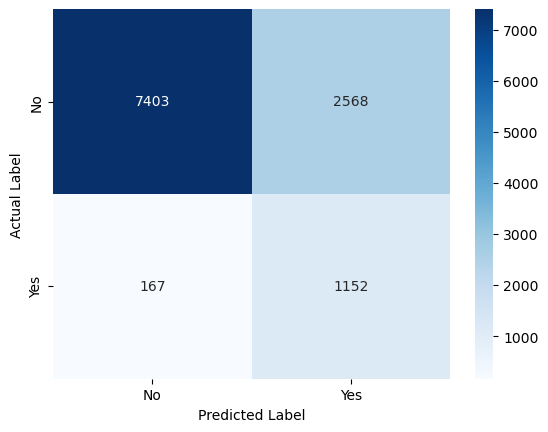

Specifity: 74.25%
Negative Predictive Value: 97.79%


In [354]:
cm = confusion_matrix(y_test_v2, opt_best.predict(X_test_v3))

#Display as heatmap
sns.heatmap(cm, annot=True, cmap='Blues', fmt='d')

#Set labels and ticks for the plot
plt.xlabel('Predicted Label')
plt.ylabel('Actual Label')
plt.xticks(ticks=[0.5, 1.5], labels=['No', 'Yes'])
plt.yticks(ticks=[0.5, 1.5], labels=['No', 'Yes'])

#Show the plot
plt.show()

#The confusion matrix below show that the prediction captures the following:

tp, fp, fn, tn = 1152, 2568, 167, 7403

print(f'Specifity: {(tn/(tn+fp))*100:.2f}%')
#specificity measures how well the model can identify negative cases
print(f'Negative Predictive Value: {(tn/(tn+fn))*100:.2f}%')
#measures the probability that a negative prediction is correct

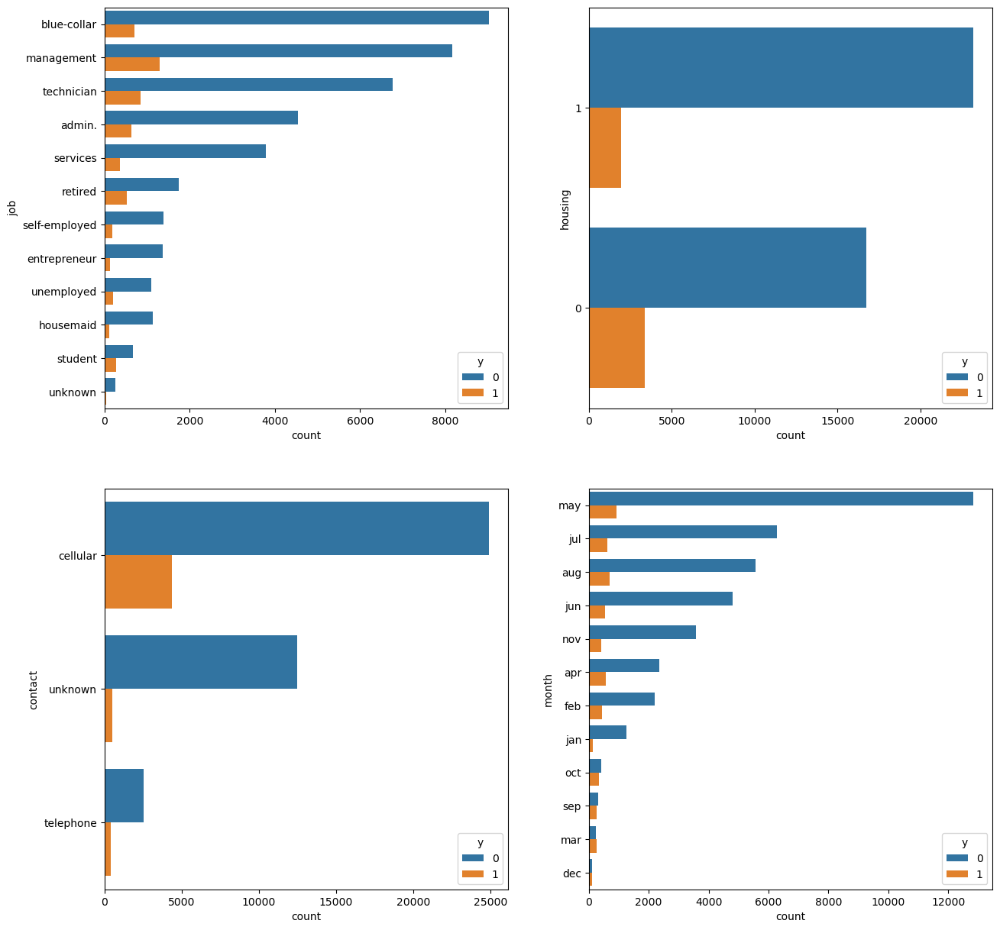

In [369]:
#Inspect useful insights related to feature selection
lasso_param = ['job', 'housing', 'contact', 'month', 'duration']

row = 2
col = 2

counter = 0
fig, ax = plt.subplots(row,col, figsize=(15,15))

for i in range(row):
    for j in range(col):
        order = df_v2[lasso_param[counter]].value_counts().index
        sns.countplot(data=df_v2, y=lasso_param[counter], hue='y', order=order, ax=ax[i,j])
        counter += 1
        
#No peculiar relationship can be summarized with these diagrams (in terms of this classification problem)

C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\seaborn\distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
C:\Users\krist\anaconda3\envs\UBerkeley-Environment\lib\site-packages\seaborn\distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),


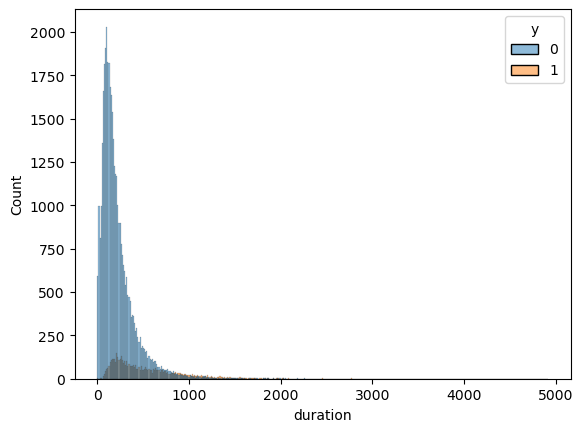

In [374]:
sns.histplot(data=df_v2, x=lasso_param[-1], hue='y');
#No peculiar relationship can be summarized with these diagrams (in terms of this classification problem)
#Outliers on this data set have been solved via Normalization (scaling/log-transform)

# Evaluation:

The following are my findings that can potentially improve my model and other useful information that I can share with the client:
    
##### A. Internal Findings
1. The use of a powerful machine to run slightly complex models is a must to ensure processing speed
    - This is specially true for `SVC, KNN, and SGDClassifier` (arranged from highest execution time to lowest)
    - Experimentation can be done with these models but a significant blocker is the compute resource and time of execution
2. Based on the final model, the most important features that allows for predicting the target are as follows:
    - `job`
    - `housing`
    - `contact`
    - `month`
    - `duration`
3. `DecisionTree` was the best model - however, the model has to be optimized to improve the `Recall` metric
4. Applying `resampling techniques` for this problem have significantly improve the model prediction by almost `~40%` from the base Recall score
5. Applying `feature selection` allowed for the complexity of parameters yielding a higher recall score to be reduce, improving overall performance of the model
    - The use of `feature selection` with classification problems will not affect the results of the model even if used early on the process and could even improve performance
6. Using `GridSearchCV` and `HalvingRandomSearchCV` did not produce significant different on Recall scores
    - HalvingRandomSearchCV was able to get the optimal values in a relatively fast rate compared with GridSearchCV
7. Selecting the best score is not enough as we have to ensure that the best parameters would make sense
    - I have extracted the `cv_results`, analyzed which set of parameters does makes sense from the top ranked scores, and have selected it as the best parameters for my final model
8. The final model yielded an `87.34%` recall score, which matches with the goal for this project
9. We can revisit a more robust way to handle the following:
    - Sampling - as resampling techniques used namely `ROS/RUS` either trims the majority target data or creates random duplicates of the minority target data - which can create less optimal solutions
    - Normalization - as the normalization technique that I used namely `log-transformation` trimmed some data (but this has been minimized with trial/error)
    - Outlier Trimming - instead of the `log-transform` used, a consideration of just removing the outliers directly and testing could potentially yield to interesting results
    - Model Selection - this is affected with the compute resource that I use when training the model
10. Some information have minority records that are unknown (that was retained), which could have been trimmed and tested if it will improve performance

##### B. Client Information
1. Majority of the dataset is `imbalanced`
    - As this is a production data (of bank clients related to term deposit subscription), there is dataset limitation with respect to this factor
2. Some features have `unknown` record values
    - This could be improved by the bank in order to ensure that a clean data is available for data analysis
3. `May` is a busy month for attempting to convince clients for a term deposit subscription
    - This is an assertion based on this one-year data snapshot and can be used to improve activity and resource allocation when trying to contact clients to convince for a term deposit subscription

# Deployment:

Here is the summary report that can be provided to the client:
    
Goal: **The classification goal is to predict if the client will subscribe a term deposit (variable y).**

    
Based on the results of this analysis, we can conclude that an `optimized DecisionTree model` is able to predict the classification of the client (subscription to term deposit) with a `Recall` score fo `87.34%` based on the following factors:
    - `job`
    - `housing`
    - `contact`
    - `month`
    - `duration`
    
To improve future models, investment on data management and model resource utilization must be considered
   - Unknown values have to be cleaned up as this will not offer additional insight in this context
   - Ensure that sufficient compute resources are invested to explore other alternatives if a higher degree of Recall score is considered
   - To create a more robust model, explore options to allow the improvement of Precision and/or F1 score as required.

In [342]:
#####################################################

# Notes

### Importing the models (base for comparison - local) in case it crashes (again..)

In [76]:


# Trained model
model1_hrd = opti1_hrd

# Save the model to a file
with open('model1_hrd.pkl', 'wb') as f:
    pickle.dump(model1_hrd, f)


In [77]:
# Trained model
model2_hrd = opti2_hrd

# Save the model to a file
with open('model2_hrd.pkl', 'wb') as f:
    pickle.dump(model2_hrd, f)

In [78]:
# Trained model
model3_hrd = opti3_hrd

# Save the model to a file
with open('model3_hrd.pkl', 'wb') as f:
    pickle.dump(model3_hrd, f)

In [79]:
# Trained model
model4_hrd = opti4_hrd

# Save the model to a file
with open('model4_hrd.pkl', 'wb') as f:
    pickle.dump(model4_hrd, f)

In [80]:
# Trained model
model5_hrd = opti5_hrd

# Save the model to a file
with open('model5_hrd.pkl', 'wb') as f:
    pickle.dump(model5_hrd, f)

In [81]:
# Trained model
model1_gcv = opti1_gcv

# Save the model to a file
with open('model1_gcv.pkl', 'wb') as f:
    pickle.dump(model1_gcv, f)

In [82]:
# Trained model
model2_gcv = opti2_gcv

# Save the model to a file
with open('model2_gcv.pkl', 'wb') as f:
    pickle.dump(model2_gcv, f)

In [83]:
# Trained model
model3_gcv = opti3_gcv

# Save the model to a file
with open('model3_gcv.pkl', 'wb') as f:
    pickle.dump(model3_gcv, f)

In [84]:
# Trained model
model4_gcv = opti4_gcv

# Save the model to a file
with open('model4_gcv.pkl', 'wb') as f:
    pickle.dump(model4_gcv, f)